In [30]:
# import boto3
import pdal
import json
import sys
import geopandas as gpd
from shapely.geometry import Polygon
from shapely.geometry import Point
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d


In [4]:
s3 = boto3.resource("s3")
s3_bucket = s3.Bucket('usgs-lidar-public')

In [6]:
# files_in_s3 = [f.key for f in s3_bucket.objects]


In [19]:
import geopandas as gpd
from shapely.geometry import Polygon

MINX, MINY, MAXX, MAXY = [-93.756155, 41.918015, -93.747334, 41.921429]
polygon = Polygon(((MINX, MINY), (MINX, MAXY),
                  (MAXX, MAXY), (MAXX, MINY), (MINX, MINY)))

grid = gpd.GeoDataFrame([polygon], columns=["geometry"])
# grid.set_crs(epsg=4326, inplace=True)


In [118]:
s2 = gpd.GeoDataFrame([Point(-93.75, 41.919),
                       Point(0, 0),
                       Point(0, 1), ], columns=["geometry"])
s2.set_crs(epsg=4326, inplace=True)

,geometry
0,POINT (-93.75000 41.91900)
1,POINT (0.00000 0.00000)
2,POINT (0.00000 1.00000)


In [121]:
# s2[grid.geometry.contains(s2.geometry)]
polygon.contains(Point(-93.756155, 41.918015))


False

In [6]:
new_polygon = Polygon(((15,20),(16,21),(18,22),(29,22),(15,20)))

In [14]:
MINX, MINY, MAXX, MAXY = new_polygon.bounds
MAXY

22.0

In [24]:
class DataFetcher():
    def __init__(self,polygon:Polygon, region:str, epsg:str) -> None:
        self.get_polygon_edges(polygon, epsg)
        self.data_location = "https://s3-us-west-2.amazonaws.com/usgs-lidar-public/"
        self.load_pipeline_template()
        self.region = region
        self.epsg = epsg

    def load_pipeline_template(self,file_name='./pipeline_template.json'):
        with open(file_name, 'r') as read_file:
            template = json.load(read_file)

        self.template_pipeline = template

    def get_polygon_edges(self, polygon:Polygon, epsg:str):
        grid = gpd.GeoDataFrame([polygon], columns=["geometry"])
        grid.set_crs(epsg=epsg, inplace=True)

        grid['geometry'] = grid.geometry.to_crs(epsg=3857)

        minx, miny, maxx, maxy = grid.geometry[0].bounds
        # bounds: ([minx, maxx], [miny, maxy])
        self.extraction_bounds = f"({[minx, maxx]},{[miny,maxy]})"

        # Cropping Bounds
        self.polygon_cropping = self.get_crop_polygon(grid.geometry[0])

        grid['geometry'] = grid.geometry.to_crs(epsg=epsg)
        self.geo_df = grid

    def get_crop_polygon(self, polygon:Polygon):
        polygon_cords = 'POLYGON(('
        for i in list(polygon.exterior.coords):
            polygon_cords += f'{i[0]} {i[1]},'

        polygon_cords = polygon_cords[:-1] + '))'

        return polygon_cords

    def construct_simple_pipeline(self, sampling_raidus:int=4):
        self.pipeline = []
        reader = self.template_pipeline['reader']
        reader['bounds'] = self.extraction_bounds
        reader['filename'] = self.data_location + self.region + "/ept.json"
        self.pipeline.append(reader)

        cropper = self.template_pipeline['cropping_filter']
        cropper['polygon'] = self.polygon_cropping
        self.pipeline.append(cropper)

        sampler = self.template_pipeline['sampling_filter']
        sampler['radius'] = sampling_raidus
        self.pipeline.append(sampler)

        self.pipeline.append(self.template_pipeline['range_filter'])
        self.pipeline.append(self.template_pipeline['assign_filter'])

        reprojection = self.template_pipeline['reprojection_filter']
        reprojection['out_srs'] = f"EPSG:{self.epsg}"
        self.pipeline.append(reprojection)

        self.pipeline = pdal.Pipeline(json.dumps(self.pipeline))

    def construct_pipeline(self,file_name:str, resolution:int=1,window_size:int=6, tif_values:list=["all"]):
        self.pipeline = []
        reader = self.template_pipeline['reader']
        reader['bounds'] = self.extraction_bounds
        reader['filename'] = self.data_location + self.region + "/ept.json"
        self.pipeline.append(reader)

        self.pipeline.append(self.template_pipeline['range_filter'])
        self.pipeline.append(self.template_pipeline['assign_filter'])
        
        reprojection = self.template_pipeline['reprojection_filter']
        reprojection['out_srs'] = f"EPSG:{self.epsg}"
        self.pipeline.append(reprojection)

        # Simple Morphological Filter
        self.pipeline.append(self.template_pipeline['smr_filter'])
        self.pipeline.append(self.template_pipeline['smr_range_filter'])

        laz_writer = self.template_pipeline['laz_writer']
        laz_writer['filename'] = f"{file_name}_{self.region}.laz"
        self.pipeline.append(laz_writer)

        tif_writer = self.template_pipeline['tif_writer']
        tif_writer['filename'] = f"{file_name}_{self.region}.tif"
        tif_writer['output_type'] = tif_values
        tif_writer["resolution"] = resolution
        tif_writer["window_size"] = window_size
        self.pipeline.append(tif_writer)


        self.pipeline = pdal.Pipeline(json.dumps(self.pipeline))

    def get_data(self):
        # try:
        self.data_count = self.pipeline.execute()

        # except Exception as e:
        #     pass
        #     sys.exit(1)

    def get_pipeline_arrays(self):
        return self.pipeline.arrays

    def get_pipeline_metadata(self):
        return self.pipeline.metadata

    def get_pipeline_log(self):
        return self.pipeline.log

    def elevation_geodf(self):
        elevation = gpd.GeoDataFrame()
        elevations = []
        points = []
        for row in self.get_pipeline_arrays()[0]:
            lst = row.tolist()[-3:]
            elevations.append(lst[2])
            point = Point(lst[0], lst[1])
            points.append(point)

        elevation['elevation'] = elevations
        elevation['geometry'] = points
        elevation.set_crs(epsg=self.epsg, inplace=True)

        self.elevation_geodf = elevation

    def draw_basic(self, factor_value:int=1):
        values = []
        for row in df.get_pipeline_arrays()[0]:
            lst = row.tolist()[-3:]
            values.append(lst)

        values = np.array(values)
        values = values[::factor_value]

        fig = plt.figure(figsize=(10, 15))


        ax = plt.axes(projection='3d')

        ax.scatter3D(values[:, 0], values[:, 1],
                    values[:, 2], c=values[:, 2], s=0.1, cmap='terrain')

        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        ax.set_zlabel('Elevation')

        # ax.view_init(0,0)

        plt.show()


In [25]:
df = DataFetcher(polygon=polygon, region="IA_FullState", epsg="4326")

In [32]:
df.construct_simple_pipeline(sampling_raidus=2)


In [33]:
df.get_data()

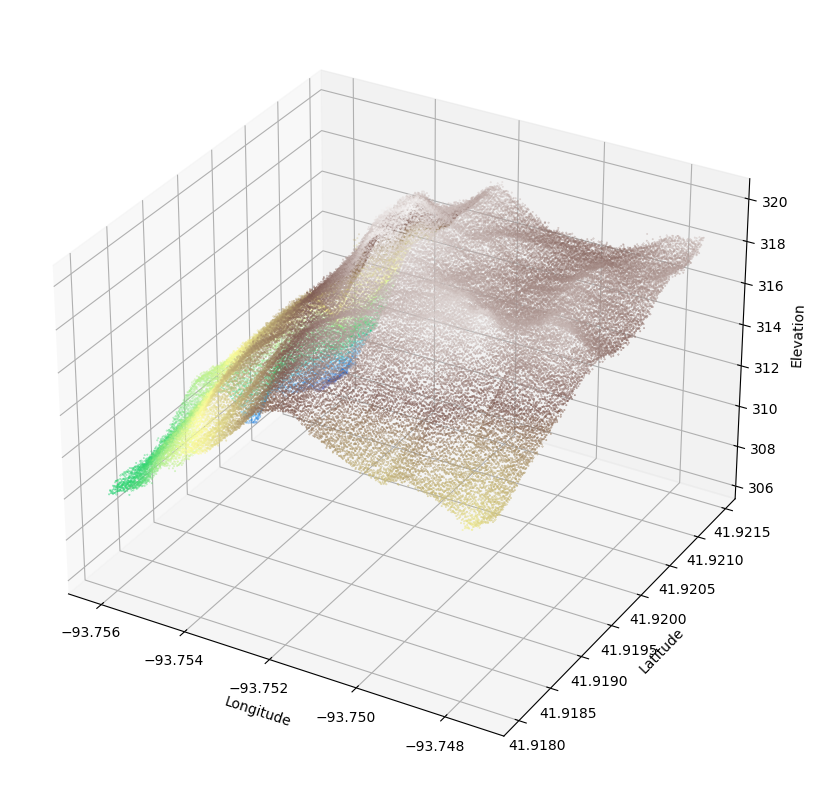

In [34]:
df.draw_basic()

In [15]:
arr = df.get_pipeline_arrays()

In [16]:
len(arr[0])

19731

In [8]:
df.elevation_geodf()

In [9]:
df.elevation_geodf.sample(10)

,elevation,geometry
221833,318.45,POINT (-93.75138 41.91976)
274778,314.86,POINT (-93.75433 41.92062)
122731,316.88,POINT (-93.74912 41.91869)
95031,316.53,POINT (-93.75376 41.92013)
109567,309.52,POINT (-93.75556 41.92091)
200528,317.43,POINT (-93.74948 41.92019)
72816,315.30,POINT (-93.74765 41.91855)
263826,316.60,POINT (-93.75384 41.91967)
17342,317.50,POINT (-93.75032 41.92038)
397064,317.37,POINT (-93.74763 41.91980)


In [10]:
elevation = df.elevation_geodf

In [11]:
a = df.get_pipeline_arrays()

In [12]:
 values = []
 for row in df.get_pipeline_arrays()[0]:
    lst = row.tolist()[-3:]
    values.append(lst)


In [13]:
import numpy as np
values = np.array(values)

In [14]:
values.shape

(401577, 3)

In [15]:
values = values[::10]

In [16]:
values.shape

(40158, 3)

In [36]:
%matplotlib notebook

In [37]:
fig = plt.figure(figsize=(10,15))
ax = plt.axes(projection='3d')

ax.scatter3D(values[:, 0], values[:, 1],
           values[:, 2], c=values[:, 2], s=0.1, cmap='terrain')

ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Elevation')

# ax.view_init(0,0)

plt.show()

<IPython.core.display.Javascript object>

In [187]:
elevation.plot()

<AxesSubplot:>

In [161]:
a = df.geo_df.geometry[0]

shapely.geometry.polygon.Polygon

In [174]:
a = polygon
polygon1 = 'POLYGON(('
for i in list(a.exterior.coords):
    polygon1 += f'{i[0]} {i[1]},'

polygon1 = polygon1[:-1] + '))'

polygon1

'POLYGON((-93.756155 41.918015,-93.756155 41.921429,-93.747334 41.921429,-93.747334 41.918015,-93.756155 41.918015))'

In [157]:
elev.head()

,elevation,geometry
0,317.59,POINT (-93.74864 41.92142)
1,317.42,POINT (-93.74863 41.92142)
2,317.27,POINT (-93.74862 41.92142)
3,317.28,POINT (-93.74865 41.92142)
4,317.25,POINT (-93.74867 41.92142)


In [154]:
elev.head(10)

,elevation,geometry
0,317.59,POINT (-93.74864 41.92142)


In [74]:
df.data_count

401493

In [3]:
# import os
# from glob import glob
# import matplotlib.pyplot as plt
# import rasterio as rio
# from rasterio.plot import plotting_extent
# import geopandas as gpd
# import earthpy as et
# import earthpy.spatial as es
# import earthpy.plot as ep


In [11]:
import numpy as np
import laspy as lp
# import lazrs

In [12]:
point_cloud = lp.read('./iowa.laz')
# lp.LazBackend.detect_available()

In [20]:
point_cloud

<LasHeader(1.2, <PointFormat(3, 0 bytes of extra dims)>)>

In [61]:
points = np.vstack((point_cloud.x, point_cloud.y, point_cloud.z)).transpose()

colors = np.vstack((point_cloud.red, point_cloud.green, point_cloud.blue)).transpose()

In [66]:
type(points)

numpy.ndarray

In [3]:
point_cloud[:5]

<PackedPointRecord(fmt: <PointFormat(3, 0 bytes of extra dims)>, len: 5, point size: 34)>

In [8]:
len(points)

1399943

In [9]:
factor = 50
decimated_points_random = points[::factor]

In [10]:
len(decimated_points_random)
decimated_points_random.shape

(27999, 3)

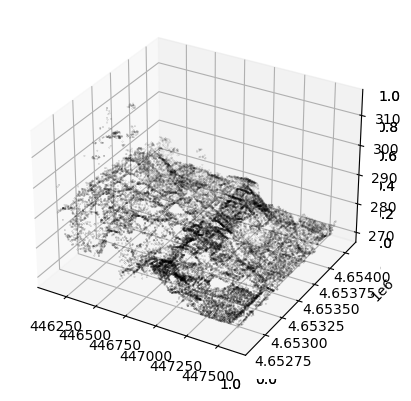

In [24]:
decimated_colors = colors[::factor]

ax = plt.axes(projection='3d')

ax.scatter(decimated_points_random[:,0], decimated_points_random[:,1],
           decimated_points_random[:,2], c=decimated_colors/65535, s=0.01)

plt.show()


In [ ]:
def factor_subsampling(point_cloud, factor):
    points = np.vstack((point_cloud.x, point_cloud.y, point_cloud.z)).transpose()
    colors = np.vstack((point_cloud.red, point_cloud.green,point_cloud.blue)).transpose()
    
    decimated_points = points[::factor]
    decimated_colors = colors[::factor]

    return decimated_points, decimated_colors

In [4]:
#Define a function that takes as input an array of points, and a voxel size expressed in meters. It returns the sampled point cloud
def grid_subsampling(point_cloud: lp.lasdata.LasData , voxel_size:int , sampling_type: str = 'closest'):
  """Get grid subsampled array of point cloud data

    Parameters
    ----------
    point_cloud : laspy.lasdata.LasData (laspy load data), required
        PackedPointRecords containing 6 Values: (x,y,z,R,G,B).
    voxel_size : int, required
        Value used to group cloud points and determine shape of the voxel to be created
        Spatial reference (CRS) of coords, defaults to ``EPSG:4326``.
    sampling_type : str, optional
        Type of grid subsampling method used, defaults to ``closest``.
        Other ``barycenter`` option available.
    Returns
    -------
    array of float
        voxel subsampled data
    """
  points = np.vstack((point_cloud.x, point_cloud.y, point_cloud.z)).transpose()

  nb_vox = np.ceil((np.max(points, axis=0) - np.min(points, axis=0)) // voxel_size)

  non_empty_voxel_keys, inverse, nb_pts_per_voxel = np.unique(
      ((points - np.min(points, axis=0)) // voxel_size).astype(int), axis=0, return_inverse=True, return_counts=True)
  idx_pts_vox_sorted = np.argsort(inverse)
  voxel_grid = {}
  grid_sampled = []
  last_seen = 0

  for idx, vox in enumerate(non_empty_voxel_keys):
    voxel_grid[tuple(vox)] = points[idx_pts_vox_sorted[last_seen:last_seen+nb_pts_per_voxel[idx]]]
    if(sampling_type == 'barycenter'):
        grid_sampled.append(np.mean(voxel_grid[tuple(vox)], axis=0))
    elif(sampling_type == 'closest'):
        grid_sampled.append(voxel_grid[tuple(vox)][np.linalg.norm(
        voxel_grid[tuple(vox)]-np.mean(voxel_grid[tuple(vox)], axis=0), axis=1).argmin()])
    else:
        raise
        
    last_seen += nb_pts_per_voxel[idx]

  return np.array(grid_sampled)


SyntaxError: invalid syntax (<ipython-input-4-105814c72c87>, line 32)

In [4]:
grid_sampled_point_cloud = grid_subsampling(point_cloud, 6)


In [6]:
arr = np.array(grid_sampled_point_cloud[1])

In [67]:
arr = np.array(grid_sampled_point_cloud)

In [69]:
arr.shape

(64930, 3)

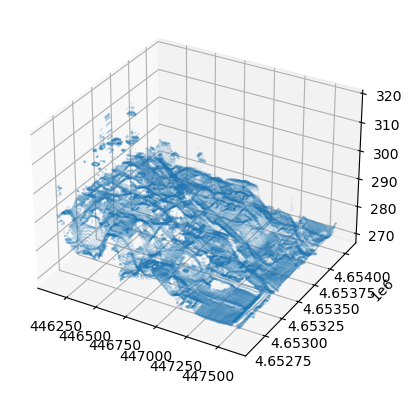

In [9]:
ax = plt.axes(projection='3d')

ax.scatter(arr[:, 0], arr[:, 1],
           arr[:, 2], s=0.01)

plt.show()


In [1]:
from subsampler import CloudSubSampler

In [2]:
sampler = CloudSubSampler(file_name='./iowa.laz')

In [4]:
sampler.separate_points_colors()

already done


In [5]:
sampler.get_grid_subsampling(voxel_size=6, sampling_type='none')

already done


RuntimeError: No active exception to reraise

In [3]:
from urllib.request import urlopen
# import json
import json

In [7]:
def get_bounds(url_str:str) -> list:
    # store the response of URL
    response = urlopen(url_str)
    # storing the JSON response
    # from url in data
    data_json = json.loads(response.read())
    # print the json response
    return data_json['bounds']


In [15]:
def construct_aws_dataset_json(directories_path:str='./filename.txt'):

    main_url = "https://usgs-lidar-public.s3.us-west-2.amazonaws.com/"
    
    dataset_json = {}

    template_dict = {
        'bounds': [],
        'years': [],
        'len': 0
    }

    with open('./filename.txt', 'r') as locations:
        locations_list = locations.readlines()


    for location in locations_list:
        location = location.replace('\n',"")[:-1]
        folder_url = main_url + location + '/ept.json'
        bound = get_bounds(folder_url)
        location = location.split('_')
        file_name = '_'.join(location[:-1])
        year = location[-1]

        if(file_name not in dataset_json):
            dataset_json[file_name] = template_dict

        dataset_json[file_name]['bounds'].append(bound)
        dataset_json[file_name]['years'].append(year)
        dataset_json[file_name]['len'] = dataset_json[file_name]['len'] + 1

    with open('./aws_dataset_info.json', 'w') as file_handler:
        json.dump(dataset_json, file_handler, sort_keys=True, indent=4)


In [17]:
# construct_aws_dataset_json()